# Capston Project FINAL assignment 





## Problem Statement 
The idea behind this project is to facilitate the fast-food business community, in this project I will use Fast food resturents data set of US.
The data set contain the information of almost 10000 fast food points throughout the country with Lists of US. Specifies the address, city, country, keys,
Longitude Latitude. postal Code, province, and websites. 
By using this data set I will try to recommend the best point for fast-food resturent to the fast food chain owners or 
if any one wants to start a new fast food point in US or a specific provenance or city as well. I will also try to explore which area is hub of the fast food points. 

## Introduction of data set 
Due to the unavailability of credit card i could not create a foursquare account so i get a data set from 
Kaggle (https://www.kaggle.com/datafiniti/fast-food-restaurants?select=FastFoodRestaurants.csv).
the data set contain the information of almost 10000 fast-food restaurant of United state of America and the attributes of the data set are 
US. Specifies the address, city, country, keys, Longitude, Latitude , postal Code, province and websites
according to the data set: 
Total 523 different chains or fast-food restaurant are working in US 
McDonald's have 1971 and Burger King 1154 Resturnts Branches 
Total number of Cites are 2777 and 54 Provinces. 

###1. Import required library 

In [2]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import seaborn as sns; sns.set()
import csv
from scipy.stats import zscore
from scipy import stats
print('Libraries imported.')

Libraries imported.


###2. import Data Set 

In [3]:
from google.colab import drive

drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [4]:
df=pd.read_csv('/content/gdrive/MyDrive/FastFoodRestaurants.csv')
df.head()

,address,city,country,keys,latitude,longitude,name,postalCode,province,websites
0,324 Main St,Massena,US,us/ny/massena/324mainst/-1161002137,44.92130,-74.89021,McDonald's,13662,NY,"http://mcdonalds.com,http://www.mcdonalds.com/..."
1,530 Clinton Ave,Washington Court House,US,us/oh/washingtoncourthouse/530clintonave/-7914...,39.53255,-83.44526,Wendy's,43160,OH,http://www.wendys.com
2,408 Market Square Dr,Maysville,US,us/ky/maysville/408marketsquaredr/1051460804,38.62736,-83.79141,Frisch's Big Boy,41056,KY,"http://www.frischs.com,https://www.frischs.com..."
3,6098 State Highway 37,Massena,US,us/ny/massena/6098statehighway37/-1161002137,44.95008,-74.84553,McDonald's,13662,NY,"http://mcdonalds.com,http://www.mcdonalds.com/..."
4,139 Columbus Rd,Athens,US,us/oh/athens/139columbusrd/990890980,39.35155,-82.09728,OMG! Rotisserie,45701,OH,"http://www.omgrotisserie.com,http://omgrotisse..."


###3.Check Latitude and Logitude and remove the outliers

In [5]:
address = 'United States, US'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of US are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of US are 39.7837304, -100.4458825.


In [6]:
q_low = df["latitude"].quantile(0.95)
q_hi  = df["latitude"].quantile(0.05)

df= df[(df["latitude"] > q_hi) & (df["longitude"] < q_low)]
q_low = df["longitude"].quantile(0.95)
q_hi  = df["longitude"].quantile(0.05)

df= df[(df["longitude"] > q_hi) & (df["longitude"] < q_low)]

In [7]:
df.describe()

,latitude,longitude
count,8524.000000,8524.000000
mean,37.639268,-91.267837
std,4.125369,12.186075
min,28.983318,-120.513420
25%,34.158539,-96.707260
50%,38.137915,-87.948816
75%,40.677312,-82.713137
max,48.635608,-73.911120


###4. Exploring the data set 

In [8]:
print('The dataframe has {} province and {} neighborhoods.'.format(
        len(df['province'].unique()),
        df.shape[0]
    )
)

The dataframe has 44 province and 8524 neighborhoods.


In [9]:
item_counts = df["province"].value_counts()
print(item_counts)

TX         544
OH         541
CA         463
IN         376
IL         361
NC         357
GA         346
MO         333
VA         325
KY         324
PA         282
MI         251
TN         245
SC         237
AL         236
LA         236
OK         208
AZ         206
WI         184
NY         180
IA         165
UT         159
MD         159
CO         158
AR         151
NJ         149
NM         149
MN         148
NV         135
SD         103
KS         102
FL         101
ID          99
WV          92
NE          91
MS          82
WA          70
ND          50
WY          41
DE          32
MT          25
DC          21
Co Spgs      5
OR           2
Name: province, dtype: int64


#### Most number of fast food resturents are in 
TX         544,   
OH         541,   
CA         463

### 5.Showing all the fastfood on the map by using Folium 

In [10]:
# create map of New York using latitude and longitude values
map_us = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, province, neighborhood in zip(df['latitude'], df['longitude'], df['city'], df['province']):
    label = '{}, {}'.format(neighborhood, province)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_us)  
    
map_us

###6 Targeted Proviance for analysis 

In [16]:
df_CTO= df.loc[df.province.isin(['CA', 'TX','OH'])]

In [17]:
df_CTO.head()

,address,city,country,keys,latitude,longitude,name,postalCode,province,websites
1,530 Clinton Ave,Washington Court House,US,us/oh/washingtoncourthouse/530clintonave/-7914...,39.53255,-83.44526,Wendy's,43160,OH,http://www.wendys.com
4,139 Columbus Rd,Athens,US,us/oh/athens/139columbusrd/990890980,39.35155,-82.09728,OMG! Rotisserie,45701,OH,"http://www.omgrotisserie.com,http://omgrotisse..."
5,4182 Tonya Trl,Hamilton,US,us/oh/hamilton/4182tonyatrl/-1055723171,39.41760,-84.47641,Domino's Pizza,45011,OH,"https://www.dominos.com/en/?redirect=homepage,..."
6,590 S Main St,Englewood,US,us/oh/englewood/590smainst/-1055723171,39.86969,-84.29358,Domino's Pizza,45322,OH,https://www.dominos.com/en/?redirect=homepagea...
22,1423 Southwest Pkwy,Wichita Falls,US,us/tx/wichitafalls/1423southwestpkwy/-1161002137,33.85371,-98.50065,McDonald's,76302,TX,http://www.mcdonalds.com/?cid=RF:YXT_FM:TP::Ye...


In [18]:
m=folium.Map(location=[latitude, longitude], zoom_start=10)
def add_marker(row):
    if row['province']=='CA':

        marker=folium.CircleMarker([row['latitude'],row['longitude']],radius=2,color='green',popup=row['name'])
        marker.add_to(m)
        
    elif row['province']=='OH': 
        marker=folium.CircleMarker([row['latitude'],row['longitude']],radius=2,color='red',popup=row['name'])
        marker.add_to(m)

    else:
        marker=folium.CircleMarker([row['latitude'],row['longitude']],radius=2,color='blue',popup=row['name'])
        marker.add_to(m)


df_CTO.apply(add_marker,axis=1)
#m.save('C:/Nishant/Gtech/folium.html')|
m

In [210]:
df_CTO.dropna(axis=0,how='any',subset=['latitude','longitude'],inplace=True)

In [33]:
def k_mean(data_frame,cluster_size,pr):
  data_frame= data_frame.loc[df.province.isin(pr)]
  X=data_frame.loc[:,['postalCode','latitude','longitude']]
  K_clusters = range(1,10)
  kmeans = [KMeans(n_clusters=i) for i in K_clusters]
  Y_axis = X[['latitude']]
  X_axis = X[['longitude']]
  score = [kmeans[i].fit(Y_axis).score(Y_axis) for i in range(len(kmeans))]
  # Visualize
  plt.plot(K_clusters, score)
  plt.xlabel('Number of Clusters')
  plt.ylabel('Score')
  plt.title('Elbow Curve')
  plt.show()
  kmeans = KMeans(n_clusters = cluster_size, init ='k-means++')
  kmeans.fit(X[X.columns[2:3]]) # Compute k-means clustering.
  X['cluster_label'] = kmeans.fit_predict(X[X.columns[1:3]])
  centers = kmeans.cluster_centers_ # Coordinates of cluster centers.
  labels = kmeans.predict(X[X.columns[1:3]]) # Labels of each point
  X.plot.scatter(x = 'latitude', y = 'longitude', c=labels, s=50, cmap='viridis',figsize=(20, 10))
  plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5,)
  clustered_data = data_frame.merge(X, left_on='postalCode', right_on='postalCode')
  clustered_data.head(5)
  map_us = folium.Map(location=[latitude, longitude], zoom_start=10)

  # add markers to map
  for lat, lng, name, neighborhood in zip(data_frame['latitude'], data_frame['longitude'], data_frame['name'], data_frame['province']):
      label = '{}, {}'.format(neighborhood, name)
      label = folium.Popup(label, parse_html=True)
      folium.CircleMarker(
          [lat, lng],
          radius=5,
          popup=label,
          color='blue',
          fill=True,
          fill_color='#3186cc',
          fill_opacity=0.7,
          parse_html=False).add_to(map_us)  
  return map_us,clustered_data


## By using K maping i mapped thye three cites in 6 cluster 

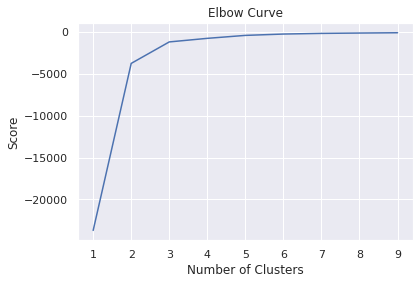

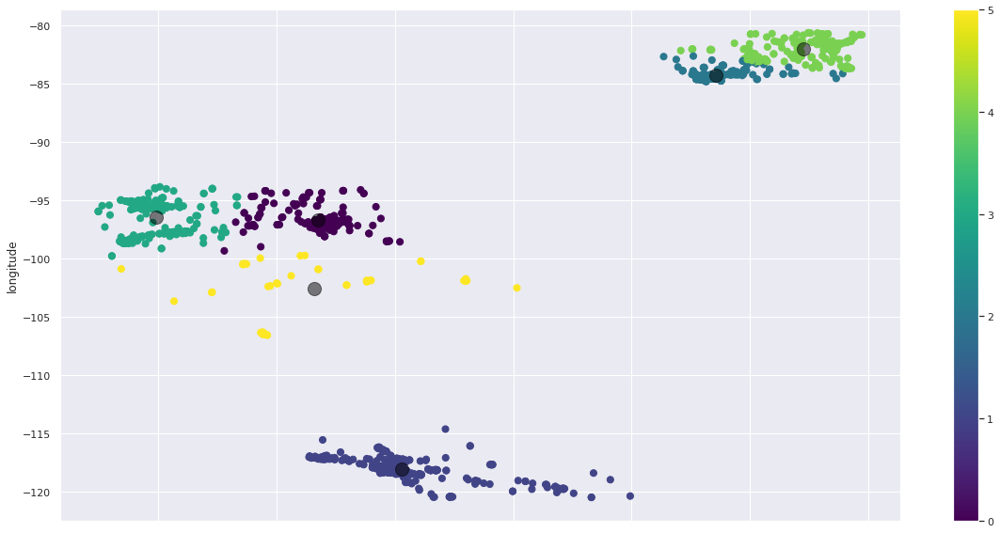

In [58]:
pr= ['CA', 'TX','OH']
data_frame=df

cluster_size=6
geo_map, pr_cl_data = k_mean(data_frame,cluster_size,pr)


In [39]:
geo_map

In [40]:
pr_cl_data.head()

,address,city,country,keys,latitude_x,longitude_x,name,postalCode,province,websites,latitude_y,longitude_y,cluster_label
0,530 Clinton Ave,Washington Court House,US,us/oh/washingtoncourthouse/530clintonave/-7914...,39.53255,-83.44526,Wendy's,43160,OH,http://www.wendys.com,39.532550,-83.445260,1
1,530 Clinton Ave,Washington Court House,US,us/oh/washingtoncourthouse/530clintonave/-7914...,39.53255,-83.44526,Wendy's,43160,OH,http://www.wendys.com,39.528330,-83.452080,1
2,530 Clinton Ave,Washington Court House,US,us/oh/washingtoncourthouse/530clintonave/-7914...,39.53255,-83.44526,Wendy's,43160,OH,http://www.wendys.com,39.552050,-83.422100,1
3,530 Clinton Ave,Washington Court House,US,us/oh/washingtoncourthouse/530clintonave/-7914...,39.53255,-83.44526,Wendy's,43160,OH,http://www.wendys.com,39.544901,-83.426653,1
4,530 Clinton Ave,Washington Court House,US,us/oh/washingtoncourthouse/530clintonave/-7914...,39.53255,-83.44526,Wendy's,43160,OH,http://www.wendys.com,39.542700,-83.426660,1


In [59]:
pr_cl_data = pr_cl_data.rename(columns={'latitude_x': 'latitude', 'longitude_x': 'longitude'})

In [82]:
def k_mean_top_chain(cl_data,cluster_size):
 
  X=cl_data.loc[:,['postalCode','latitude','longitude']]
  K_clusters = range(1,10)
  kmeans = [KMeans(n_clusters=i) for i in K_clusters]
  Y_axis = X[['latitude']]
  X_axis = X[['longitude']]
  score = [kmeans[i].fit(Y_axis).score(Y_axis) for i in range(len(kmeans))]
  # Visualize
  plt.plot(K_clusters, score)
  plt.xlabel('Number of Clusters')
  plt.ylabel('Score')
  plt.title('Elbow Curve')
  plt.show()
  kmeans = KMeans(n_clusters = cluster_size, init ='k-means++')
  kmeans.fit(X[X.columns[2:3]]) # Compute k-means clustering.
  X['cluster_label'] = kmeans.fit_predict(X[X.columns[1:3]])
  centers = kmeans.cluster_centers_ # Coordinates of cluster centers.
  labels = kmeans.predict(X[X.columns[1:3]]) # Labels of each point
  X.plot.scatter(x = 'latitude', y = 'longitude', c=labels, s=50, cmap='viridis',figsize=(20, 10))
  plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5,)
  clustered_data = data_frame.merge(X, left_on='postalCode', right_on='postalCode')
  clustered_data.head(5)
  map_us = folium.Map(location=[latitude, longitude], zoom_start=10)

  # add markers to map
  m=folium.Map(location=[latitude, longitude], zoom_start=10)
  def add_marker(row):
        if row['name']=="McDonald's":

            marker=folium.CircleMarker([row['latitude'],row['longitude']],radius=2,color='green',popup=row['name'])
            marker.add_to(m)
            
        elif row['name']=="Taco Bell": 
            marker=folium.CircleMarker([row['latitude'],row['longitude']],radius=2,color='red',popup=row['name'])
            marker.add_to(m)

        else:
            marker=folium.CircleMarker([row['latitude'],row['longitude']],radius=2,color='blue',popup=row['name'])
            marker.add_to(m)


  cl_data.apply(add_marker,axis=1)
    #m.save('C:/Nishant/Gtech/folium.html')|
  m
  return m,clustered_data

### 8. In this section i chose the top 3 resturent and distribue in cluster individual in map now you can easly decide in which are you can start your new brach according to the others two chain 

In [91]:
pr_cl_data.head()

,address,city,country,keys,latitude_x,longitude_x,name,postalCode,province,websites,latitude_y,longitude_y,cluster_label
0,2062 W Redlands Blvd,Redlands,US,us/ca/redlands/2062wredlandsblvd/-230519289,34.063455,-117.2243,Jack in the Box,92373,CA,http://www.jackinthebox.com,34.0549,-117.1756,2
1,2062 W Redlands Blvd,Redlands,US,us/ca/redlands/2062wredlandsblvd/-230519289,34.063455,-117.2243,Jack in the Box,92373,CA,http://www.jackinthebox.com,34.0549,-117.1756,2
2,2062 W Redlands Blvd,Redlands,US,us/ca/redlands/2062wredlandsblvd/-230519289,34.063455,-117.2243,Jack in the Box,92373,CA,http://www.jackinthebox.com,34.0549,-117.1756,2
3,2062 W Redlands Blvd,Redlands,US,us/ca/redlands/2062wredlandsblvd/-230519289,34.063455,-117.2243,Jack in the Box,92373,CA,http://www.jackinthebox.com,34.0549,-117.1756,2
4,2062 W Redlands Blvd,Redlands,US,us/ca/redlands/2062wredlandsblvd/-230519289,34.063455,-117.2243,Jack in the Box,92373,CA,http://www.jackinthebox.com,34.0549,-117.1756,2


In [60]:
data_top_fast_food= pr_cl_data[pr_cl_data.name.isin(["McDonald's","Taco Bell","Burger King"])]
data_top_fast_food_c1= data_top_fast_food[data_top_fast_food.cluster_label.isin(["0"])]

In [61]:
data_top_fast_food_c2= data_top_fast_food[data_top_fast_food.cluster_label.isin(["1"])]

In [62]:
data_top_fast_food_c3= data_top_fast_food[data_top_fast_food.cluster_label.isin(["2"])]

In [63]:
data_top_fast_food_c4= data_top_fast_food[data_top_fast_food.cluster_label.isin(["3"])]

In [64]:
data_top_fast_food_c5= data_top_fast_food[data_top_fast_food.cluster_label.isin(["4"])]

In [65]:
data_top_fast_food_c6= data_top_fast_food[data_top_fast_food.cluster_label.isin(["5"])]

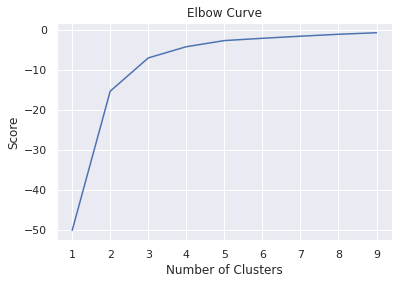

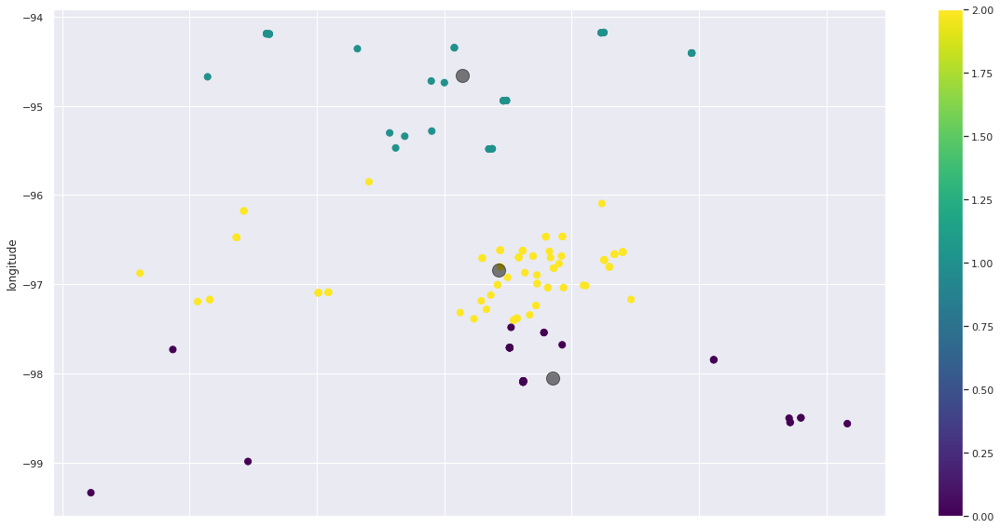

In [83]:
cl_data=data_top_fast_food_c1

cluster_size=3
geo_map_branchies, pr_cl_data = k_mean_top_chain(cl_data,cluster_size)


In [84]:
geo_map_branchies

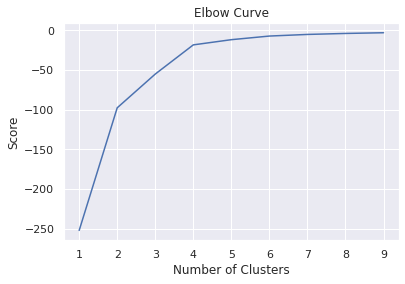

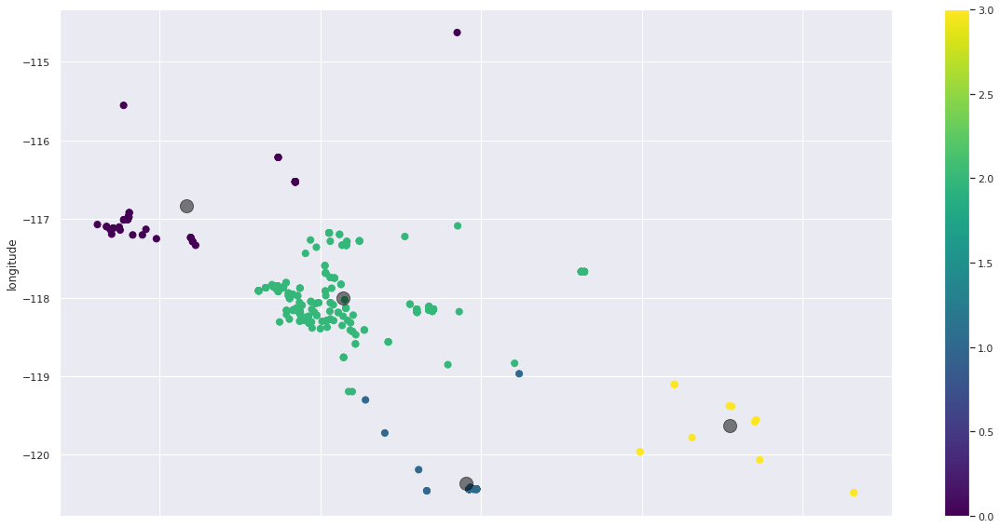

In [88]:
cl_data=data_top_fast_food_c2

cluster_size=4
geo_map_branchies, pr_cl_data = k_mean_top_chain(cl_data,cluster_size)


In [89]:
geo_map_branchies

In [93]:
cl_data=data_top_fast_food_c3

cluster_size=4
geo_map_branchies, pr_cl_data = k_mean_top_chain(cl_data,cluster_size)



,city,longitude_x,name,postalCode,province,websites,latitude_y,longitude_y,cluster_label


In [ ]:
geo_map_branchies

In [ ]:
cl_data=data_top_fast_food_c4

cluster_size=3
geo_map_branchies, pr_cl_data = k_mean_top_chain(cl_data,cluster_size)


In [ ]:
geo_map_branchies

In [ ]:
cl_data=data_top_fast_food_c5

cluster_size=3
geo_map_branchies, pr_cl_data = k_mean_top_chain(cl_data,cluster_size)


In [ ]:
geo_map_branchies

In [ ]:
cl_data=data_top_fast_food_c6

cluster_size=3
geo_map_branchies, pr_cl_data = k_mean_top_chain(cl_data,cluster_size)


In [ ]:
geo_map_branchies